This notebook is to perform the first try of topic modeling on 100 cases

### Load Required packages

In [25]:
#import all necessary cases
import pandas as pd
from pprint import pprint

In [2]:
import nltk
nltk.download('stopwords')
import gensim
from gensim.utils import simple_preprocess
from gensim.parsing.preprocessing import STOPWORDS
from nltk.stem import WordNetLemmatizer, SnowballStemmer
from nltk.stem.porter import *
import numpy as np
np.random.seed(2018)

[nltk_data] Downloading package stopwords to
[nltk_data]     /Users/shimengfeng/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [3]:
# import gensim
import gensim.corpora as corpora
# from gensim.utils import simple_preprocess
from gensim.models import CoherenceModel
from gensim.models.wrappers import LdaMallet
# spacy for lemmatization
import spacy

In [6]:
# Plotting tools
import matplotlib.pyplot as plt
%matplotlib inline

In [4]:
# NLTK Stop words
from nltk.corpus import stopwords
stop_words = stopwords.words('english')
stop_words.extend(['law','court', 'statute', 'case', 'state','make','right','may','take'])

In [5]:
def lemmatize_stemming(text):
    return stemmer.stem(WordNetLemmatizer().lemmatize(text, pos='v'))

def preprocess(text):
    result = []
    for token in gensim.utils.simple_preprocess(text):
        if token not in gensim.parsing.preprocessing.STOPWORDS and len(token) > 3:
            result.append(lemmatize_stemming(token))
    return result

In [7]:
df1 = pd.read_json('cases.json')
df1.head() #content are related text

,case_name,content,court,date,url
0,William Bartlet and Others versus James King E...,"Dewey, J.\nThe action is for a legacy given by...",Massachusetts Supreme Judicial Court,1815-11-01,https://api.case.law/v1/cases/2051940/
1,The Trustees of the Philadelphia Baptist Assoc...,Mr. Chief Justice Marshall\ndelivered the opin...,Supreme Court of the United States,1819-02-01,https://api.case.law/v1/cases/4686/
2,Griffin v. Graham and others,"Tatxojr, Chief-Justice,\ndelivered the opinion...",Supreme Court of North Carolina,1820-06-01,https://api.case.law/v1/cases/11275455/
3,UNITED STATES v. GREEN,"STORY, Circuit Justice.\nIn cases of this natu...",United States Circuit Court for the District o...,1824-11-01,https://api.case.law/v1/cases/6130377/
4,JONES v. STOCKETT,"Bland, Chancellor.\nOrdered, that Richard G. S...",High Court of Chancery of Maryland,1825-08-31,https://api.case.law/v1/cases/1718036/


In [8]:
data = df1['content'].tolist()

In [9]:
# remove new line \n
data = [re.sub("\n", " ", sent) for sent in data]
data = list(set(data))
data = [x for x in data if str(x) != 'nan' and str(x)]
len(data)

100

In [10]:
#remove punctuation and preserve the key words
def sent_to_words(sentences):
    for sentence in sentences:
        yield(gensim.utils.simple_preprocess(str(sentence), deacc=True))  # deacc=True removes punctuations
data_words = list(sent_to_words(data))


#give one example
# data_sample = [data[0]]
# case_words = list(sent_to_words(data_sample))
# print(case_words[0])

In [11]:
def remove_stopwords(texts):
    return [[word for word in simple_preprocess(str(doc)) if word not in stop_words] for doc in texts]

# Remove Stop Words
data_words_nostops = remove_stopwords(data_words)

#Example
# data_test = [data_words[0]]
# data_words_nonstops_sample = remove_stopwords(data_test)
# print(data_words_nonstops_sample[0])

In [12]:
#Bigram and Trigram
# Build the bigram and trigram models
bigram = gensim.models.Phrases(data_words, min_count=5, threshold=20) # higher threshold fewer phrases.
trigram = gensim.models.Phrases(bigram[data_words], threshold=20)  

# Faster way to get a sentence clubbed as a trigram/bigram
bigram_mod = gensim.models.phrases.Phraser(bigram)
trigram_mod = gensim.models.phrases.Phraser(trigram)

In [13]:
def make_bigrams(texts):
    return [bigram_mod[doc] for doc in texts]

def make_trigrams(texts):
    return [trigram_mod[bigram_mod[doc]] for doc in texts]

def lemmatization(texts, allowed_postags=['NOUN', 'ADJ', 'VERB', 'ADV']):
    """https://spacy.io/api/annotation"""
    texts_out = []
    for sent in texts:
        doc = nlp(" ".join(sent)) 
        texts_out.append([token.lemma_ for token in doc if token.pos_ in allowed_postags])
    return texts_out

In [14]:
# Form Bigrams
data_words_bigrams = make_bigrams(data_words_nostops)

# Initialize spacy 'en' model, keeping only tagger component (for efficiency)
# python3 -m spacy download en
nlp = spacy.load('en', disable=['parser', 'ner'])

# Example
# words_bigrams = make_bigrams(data_test)
# print(words_bigrams[0])

Finally, we would like to tackle one last challenge: The fact that a word used as a singular or plural should be considered the same. Similar case when you conjugate a verb or you use verbs and adjectives with the same origin. 

These kinds of problems are solved by _Lemmatization_ , a technique that transforms any single word to its root.

In [15]:
# Do lemmatization keeping only noun, adj, vb, adv
data_lemmatized = lemmatization(data_words_bigrams, allowed_postags=['NOUN', 'ADJ', 'VERB', 'ADV'])

# Example
# lemmatized_sample = lemmatization(data_words_bigrams, allowed_postags=['NOUN', 'ADJ', 'VERB', 'ADV'])
# print(lemmatized_sample[0])

### Model Topics

##### The first thing that we need to do is to build the corpora

In [16]:
# Create Dictionary
id2word = corpora.Dictionary(data_lemmatized)
#enesure data includes more than 5% of doc
# id2word.filter_extremes(no_above=0.03)
# Create Corpus
texts = data_lemmatized

# Term Document Frequency
corpus = [id2word.doc2bow(text) for text in texts]

# Example
# print(id2word.doc2bow(data_lemmatized[0]))

In [17]:
# Human readable format of corpus (term-frequency)
# [[(id2word[id], freq) for id, freq in cp] for cp in [id2word.doc2bow(case) for case in data_lemmatized]]

In [18]:
# Download File: http://mallet.cs.umass.edu/dist/mallet-2.0.8.zip
mallet_path = 'mallet-2.0.8/bin/mallet' # update this path
ldamallet = gensim.models.wrappers.LdaMallet(mallet_path, corpus=corpus, num_topics=10, id2word=id2word)

In [27]:
pprint(ldamallet.show_topics(formatted=False))

[(0,
  [('court', 0.02045602605863192),
   ('writ', 0.020260586319218243),
   ('jurisdiction', 0.02013029315960912),
   ('united_states', 0.018371335504885993),
   ('common', 0.015439739413680782),
   ('authority', 0.012833876221498371),
   ('united_state', 0.01276872964169381),
   ('tbe', 0.011270358306188924),
   ('act', 0.011009771986970684),
   ('grant', 0.010684039087947883)]),
 (1,
  [('child', 0.04484009231783712),
   ('custody', 0.0175568743818002),
   ('father', 0.014507088691064951),
   ('mother', 0.011045169798878998),
   ('parent', 0.011045169798878998),
   ('age', 0.009561490273656445),
   ('charge', 0.009231783712495879),
   ('order', 0.009066930431915594),
   ('care', 0.008242664029014177),
   ('duty', 0.008160237388724036)]),
 (2,
  [('act', 0.03354811598263062),
   ('bill', 0.017509455105757108),
   ('sale', 0.015828547415604428),
   ('make', 0.014777980109258999),
   ('trustee', 0.014637904468412942),
   ('legislature', 0.014497828827566886),
   ('complainant', 0.0140

In [28]:
# Compute Coherence Score
coherence_model_ldamallet = CoherenceModel(model=ldamallet, texts=data_lemmatized, dictionary=id2word, coherence='c_v')
coherence_ldamallet = coherence_model_ldamallet.get_coherence()
print('\nCoherence Score: ', coherence_ldamallet)


Coherence Score:  0.45934355251664316


### LDA with Gensim


In [46]:
lda_model = gensim.models.ldamodel.LdaModel(corpus=corpus,
                                           id2word=id2word,
                                           num_topics=10, 
                                           random_state=100,
                                           update_every=1,
                                           chunksize=100,
                                           passes=10,
                                           alpha='auto',
                                           per_word_topics=True)

In [33]:
lda_model.print_topics(0)

[(1,
  '0.019*"patent" + 0.009*"grant" + 0.008*"equity" + 0.007*"act" + 0.007*"injunction" + 0.007*"motion" + 0.007*"make" + 0.007*"bill" + 0.006*"tlie" + 0.006*"name"'),
 (2,
  '0.018*"tbe" + 0.013*"river" + 0.011*"public" + 0.009*"common" + 0.009*"rule" + 0.008*"water" + 0.006*"land" + 0.006*"grant" + 0.006*"say" + 0.006*"navigable"'),
 (3,
  '0.014*"society" + 0.013*"bequest" + 0.011*"testator" + 0.011*"person" + 0.008*"charity" + 0.008*"intend" + 0.007*"evidence" + 0.006*"object" + 0.006*"philadelphia" + 0.006*"say"'),
 (0,
  '0.019*"executor" + 0.013*"estate" + 0.011*"say" + 0.009*"testator" + 0.009*"give" + 0.009*"administrator" + 0.008*"would" + 0.008*"act" + 0.006*"person" + 0.006*"first"'),
 (8,
  '0.015*"child" + 0.012*"writ" + 0.008*"power" + 0.008*"court" + 0.007*"jurisdiction" + 0.007*"custody" + 0.007*"habeas_corpus" + 0.006*"say" + 0.006*"authority" + 0.006*"act"'),
 (4,
  '0.008*"land" + 0.008*"charity" + 0.007*"act" + 0.007*"grant" + 0.007*"make" + 0.007*"hold" + 0.006

In [49]:
# print the key words within the topics
lda_model.print_topics(0)

[(8,
  '0.197*"methodist_episcopal" + 0.041*"public_worship" + 0.035*"northern" + 0.026*"appoint_guardian" + 0.024*"route" + 0.018*"restrictive" + 0.018*"furtherance" + 0.018*"gallego" + 0.018*"displace" + 0.018*"kindness"'),
 (6,
  '0.135*"appoint_guardian" + 0.050*"lex" + 0.034*"bennett" + 0.030*"enrol" + 0.030*"providence" + 0.025*"phil" + 0.025*"park" + 0.020*"structure" + 0.020*"realty" + 0.016*"intelligent"'),
 (4,
  '0.048*"register" + 0.041*"reviser" + 0.026*"gallego" + 0.025*"leigh" + 0.023*"campbell" + 0.021*"embraced_within" + 0.020*"extra" + 0.018*"bequ" + 0.017*"pound" + 0.017*"durham"'),
 (2,
  '0.039*"eleemosynary" + 0.034*"tennessee" + 0.023*"feoffment" + 0.023*"secret" + 0.023*"physical" + 0.020*"hammond" + 0.018*"condition_broken" + 0.017*"suitable_person" + 0.017*"inmate" + 0.017*"double"'),
 (1,
  '0.251*"patent" + 0.060*"grandchild" + 0.030*"fraudulently" + 0.021*"great_seal" + 0.016*"patentee" + 0.013*"forcibly" + 0.013*"daniel" + 0.011*"instrumentality" + 0.011*"

In [30]:
lda_model.print_topics(0)

[(8,
  '0.038*"referee" + 0.025*"unborn" + 0.019*"rehear" + 0.019*"municipality" + 0.014*"enrolment" + 0.014*"rehearing" + 0.014*"ecclesiastical_court" + 0.014*"burthen" + 0.014*"taxing_power" + 0.014*"tax_payer"'),
 (7,
  '0.061*"physician" + 0.024*"lord_thurlow" + 0.023*"civil_procedure" + 0.018*"subscribe" + 0.018*"felony" + 0.012*"preside" + 0.012*"representation" + 0.012*"disclosure" + 0.009*"scott" + 0.009*"interlocutory"'),
 (2,
  '0.025*"edw_vi" + 0.023*"divine_service" + 0.021*"alabama" + 0.019*"plowd" + 0.019*"duke_char" + 0.017*"poph" + 0.016*"abbot" + 0.014*"religious_worship" + 0.011*"first_settlement" + 0.011*"swinb"'),
 (6,
  '0.035*"foreign_mission" + 0.032*"mercein" + 0.030*"congregational" + 0.027*"bollman_cranch" + 0.027*"first_congregational" + 0.024*"missionary" + 0.018*"eleventh" + 0.013*"fourteenth_section" + 0.012*"blackf" + 0.010*"prosecutor"'),
 (4,
  '0.062*"physician" + 0.029*"mental" + 0.019*"ms" + 0.019*"gold" + 0.019*"parol" + 0.015*"curator" + 0.015*"cur

In [53]:
lda_model.show_topics()

[(0,
  '0.031*"patent" + 0.029*"serg" + 0.027*"jac" + 0.021*"alm" + 0.020*"immunity" + 0.019*"superstition" + 0.017*"escheat" + 0.017*"superstitious_uses" + 0.016*"chattel" + 0.015*"binn"'),
 (1,
  '0.251*"patent" + 0.060*"grandchild" + 0.030*"fraudulently" + 0.021*"great_seal" + 0.016*"patentee" + 0.013*"forcibly" + 0.013*"daniel" + 0.011*"instrumentality" + 0.011*"alm" + 0.011*"accounting"'),
 (2,
  '0.039*"eleemosynary" + 0.034*"tennessee" + 0.023*"feoffment" + 0.023*"secret" + 0.023*"physical" + 0.020*"hammond" + 0.018*"condition_broken" + 0.017*"suitable_person" + 0.017*"inmate" + 0.017*"double"'),
 (3,
  '0.041*"reasonable_time" + 0.041*"sailor" + 0.025*"bible_society" + 0.021*"route" + 0.019*"zanesville" + 0.017*"advantageous" + 0.017*"public_worship" + 0.016*"vigilance" + 0.016*"abeyance" + 0.016*"persuasion"'),
 (4,
  '0.048*"register" + 0.041*"reviser" + 0.026*"gallego" + 0.025*"leigh" + 0.023*"campbell" + 0.021*"embraced_within" + 0.020*"extra" + 0.018*"bequ" + 0.017*"pound"

### Discover the best number of topics

In [29]:
def compute_coherence_values(dictionary, corpus, texts, limit, start=2, step=3):
    """
    Compute c_v coherence for various number of topics

    Parameters:
    ----------
    dictionary : Gensim dictionary
    corpus : Gensim corpus
    texts : List of input texts
    limit : Max num of topics

    Returns:
    -------
    model_list : List of LDA topic models
    coherence_values : Coherence values corresponding to the LDA model with respective number of topics
    """
    coherence_values = []
    model_list = []
    for num_topics in range(start, limit, step):
        model = gensim.models.wrappers.LdaMallet(mallet_path, corpus=corpus, num_topics=num_topics, id2word=id2word, random_seed = 2019)
        model_list.append(model)
        coherencemodel = CoherenceModel(model=model, texts=texts, dictionary=dictionary, coherence='c_v')
        coherence_values.append(coherencemodel.get_coherence())

    return model_list, coherence_values

In [30]:
# Can take a long time to run.
model_list, coherence_values = compute_coherence_values(dictionary=id2word, corpus=corpus, texts=data_lemmatized, start=2, limit=20, step=2)

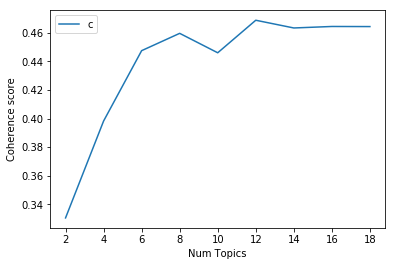

In [32]:
# Show graph
limit=20; start=2; step=2;
x = range(start, limit, step)
plt.plot(x, coherence_values)
plt.xlabel("Num Topics")
plt.ylabel("Coherence score")
plt.legend(("coherence_values"), loc='best')
plt.show()

In [34]:
# Print the coherence scores
for m, cv in zip(x, coherence_values):
    print("Num Topics =", m, " has Coherence Value of", round(cv, 4))

Num Topics = 2  has Coherence Value of 0.3304
Num Topics = 4  has Coherence Value of 0.3983
Num Topics = 6  has Coherence Value of 0.4476
Num Topics = 8  has Coherence Value of 0.4597
Num Topics = 10  has Coherence Value of 0.4461
Num Topics = 12  has Coherence Value of 0.4689
Num Topics = 14  has Coherence Value of 0.4635
Num Topics = 16  has Coherence Value of 0.4645
Num Topics = 18  has Coherence Value of 0.4644


### Identify the distribution of topics

In [36]:
optimal_model = model_list[4]

In [37]:
def format_topics_sentences(ldamodel=optimal_model, corpus=corpus, texts=data):
    # Init output
    sent_topics_df = pd.DataFrame()

    # Get main topic in each document
    for i, row in enumerate(ldamodel[corpus]):
        row = sorted(row, key=lambda x: (x[1]), reverse=True)
        # Get the Dominant topic, Perc Contribution and Keywords for each document
        for j, (topic_num, prop_topic) in enumerate(row):
            if j == 0:  # => dominant topic
                wp = ldamodel.show_topic(topic_num)
                topic_keywords = ", ".join([word for word, prop in wp])
                sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
            else:
                break
    sent_topics_df.columns = ['Dominant_Topic', 'Perc_Contribution', 'Topic_Keywords']

    # Add original text to the end of the output
    contents = pd.Series(texts)
    sent_topics_df = pd.concat([sent_topics_df, contents], axis=1)
    return(sent_topics_df)


df_topic_sents_keywords = format_topics_sentences(ldamodel=optimal_model, corpus=corpus, texts=data)

# Format
df_dominant_topic = df_topic_sents_keywords.reset_index()
df_dominant_topic.columns = ['Document_No', 'Dominant_Topic', 'Topic_Perc_Contrib', 'Keywords', 'Text']

In [38]:
# Show
pd.set_option('display.max_colwidth', -1)
df_dominant_topic.head(20)

Document_No  Dominant_Topic  Topic_Perc_Contrib  \
0   0            6.0             0.7145               
1   1            3.0             0.5333               
2   2            0.0             0.6263               
3   3            2.0             0.4584               
4   4            9.0             0.6997               
5   5            9.0             0.7263               
6   6            6.0             0.3967               
7   7            8.0             0.2647               
8   8            3.0             0.5094               
9   9            2.0             0.4192               
10  10           5.0             0.2732               
11  11           3.0             0.2815               
12  12           5.0             0.6158               
13  13           7.0             0.7513               
14  14           2.0             0.6128               
15  15           9.0             0.6141               
16  16           4.0             0.3293               
17  17           1.0             0.3815               
18  18           2.0             0.3765               
19  19           6.0             0.4116               

                                                                                           Keywords  \
0   power, estate, devise, property, act, legislature, rule, question, give, pass                     
1   child, father, custody, order, parent, mother, charge, care, age, evidence                        
2   executor, administrator, estate, debt, administration, act, intestate, testator, creditor, give   
3   trust, charity, trustee, bequest, object, testator, chancery, charitable_us, elizabeth, give      
4   court, jurisdiction, power, writ, authority, act, united_states, judge, constitution, exercise    
5   court, jurisdiction, power, writ, authority, act, united_states, judge, constitution, exercise    
6   power, estate, devise, property, act, legislature, rule, question, give, pass                     
7   county, action, money, public, act, defendant, attorney_general, duty, property, hold             
8   child, father, custody, order, parent, mother, charge, care, age, evidence                        
9   trust, charity, trustee, bequest, object, testator, chancery, charitable_us, elizabeth, give      
10  guardian, infant, person, order, give, appoint, defendant, trustee, interest, estate              
11  child, father, custody, order, parent, mother, charge, care, age, evidence                        
12  guardian, infant, person, order, give, appoint, defendant, trustee, interest, estate              
13  land, statute, charity, hold, common, eliz, good, king, principle, equity                         
14  trust, charity, trustee, bequest, object, testator, chancery, charitable_us, elizabeth, give      
15  court, jurisdiction, power, writ, authority, act, united_states, judge, constitution, exercise    
16  church, tbe, public, rule, land, property, grant, city, deed, river                               
17  bill, act, make, grant, complainant, company, contract, trustee, suit, party                      
18  trust, charity, trustee, bequest, object, testator, chancery, charitable_us, elizabeth, give      
19  power, estate, devise, property, act, legislature, rule, question, give, pass                     

                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                            

In [43]:
pd.set_option('display.max_colwidth', -1)
pd.set_option('display.max_rows', 500)
# Group top 5 sentences under each topic
sent_topics_sorteddf_mallet = pd.DataFrame()

sent_topics_outdf_grpd = df_topic_sents_keywords.groupby('Dominant_Topic')

for i, grp in sent_topics_outdf_grpd:
    sent_topics_sorteddf_mallet = pd.concat([sent_topics_sorteddf_mallet, 
                                             grp.sort_values(['Perc_Contribution'], ascending=[0]).head(10)], 
                                            axis=0)

# Reset Index    
sent_topics_sorteddf_mallet.reset_index(drop=True, inplace=True)

# Format
sent_topics_sorteddf_mallet.columns = ['Topic_Num', "Topic_Perc_Contrib", "Keywords", "Text"]

# Show
sent_topics_sorteddf_mallet

Topic_Num  Topic_Perc_Contrib  \
0   0.0        0.7428               
1   0.0        0.6263               
2   0.0        0.5891               
3   0.0        0.3652               
4   0.0        0.3008               
5   1.0        0.6402               
6   1.0        0.5929               
7   1.0        0.5716               
8   1.0        0.4605               
9   1.0        0.4036               
10  1.0        0.3815               
11  1.0        0.3110               
12  1.0        0.2724               
13  1.0        0.2372               
14  2.0        0.6335               
15  2.0        0.6128               
16  2.0        0.5562               
17  2.0        0.5215               
18  2.0        0.5035               
19  2.0        0.5032               
20  2.0        0.4916               
21  2.0        0.4603               
22  2.0        0.4584               
23  2.0        0.4542               
24  3.0        0.5994               
25  3.0        0.5874               
26  3.0        0.5545               
27  3.0        0.5372               
28  3.0        0.5333               
29  3.0        0.5094               
30  3.0        0.4947               
31  3.0        0.4801               
32  3.0        0.4494               
33  3.0        0.4175               
34  4.0        0.6692               
35  4.0        0.5459               
36  4.0        0.3640               
37  4.0        0.3293               
38  4.0        0.2933               
39  4.0        0.2644               
40  5.0        0.6158               
41  5.0        0.6071               
42  5.0        0.5598               
43  5.0        0.5380               
44  5.0        0.5251               
45  5.0        0.4099               
46  5.0        0.3467               
47  5.0        0.2732               
48  5.0        0.2250               
49  6.0        0.7145               
50  6.0        0.6099               
51  6.0        0.5988               
52  6.0        0.5169               
53  6.0        0.5080               
54  6.0        0.4940               
55  6.0        0.4832               
56  6.0        0.4116               
57  6.0        0.3991               
58  6.0        0.3967               
59  7.0        0.7525               
60  7.0        0.7513               
61  8.0        0.7413               
62  8.0        0.7108               
63  8.0        0.4051               
64  8.0        0.3908               
65  8.0        0.2647               
66  9.0        0.7263               
67  9.0        0.6997               
68  9.0        0.6141               
69  9.0        0.4890               
70  9.0        0.2462               
71  9.0        0.2342               
72  9.0        0.2266               
73  9.0        0.1414               

                                                                                           Keywords  \
0   executor, administrator, estate, debt, administration, act, intestate, testator, creditor, give   
1   executor, administrator, estate, debt, administration, act, intestate, testator, creditor, give   
2   executor, administrator, estate, debt, administration, act, intestate, testator, creditor, give   
3   executor, administrator, estate, debt, administration, act, intestate, testator, creditor, give   
4   executor, administrator, estate, debt, administration, act, intestate, testator, creditor, give   
5   bill, act, make, grant, complainant, company, contract, trustee, suit, party                      
6   bill, act, make, grant, complainant, company, contract, trustee, suit, party                      
7   bill, act, make, grant, complainant, company, contract, trustee, suit, party                      
8   bill, act, make, grant, complainant, company, contract, trustee, suit, party                      
9   bill, act, make, grant, complainant, company, contract, trustee, suit, party                      
10  bill, act, make, grant, complainant, company, contract, trustee, suit, party               

In [51]:
# Number of Documents for Each Topic
topic_counts = df_topic_sents_keywords['Dominant_Topic'].value_counts().sort_index()

# Percentage of Documents for Each Topic
topic_contribution = round(topic_counts/topic_counts.sum(), 4).sort_index()

# Topic Number and Keywords
topic_num_keywords = df_topic_sents_keywords[['Dominant_Topic', 'Topic_Keywords']].drop_duplicates()\
    .sort_values('Dominant_Topic').reset_index(drop=True)

# Concatenate Column wise
df_dominant_topics = pd.concat([topic_num_keywords, topic_counts, topic_contribution], axis=1)

# Change Column names
df_dominant_topics.columns = ['Dominant_Topic', 'Topic_Keywords', 'Num_Documents', 'Perc_Documents']

# Show
df_dominant_topics

,Dominant_Topic,Topic_Keywords,Num_Documents,Perc_Documents
0,0.0,"executor, administrator, estate, debt, administration, act, intestate, testator, creditor, give",5,0.05
1,1.0,"bill, act, make, grant, complainant, company, contract, trustee, suit, party",9,0.09
2,2.0,"trust, charity, trustee, bequest, object, testator, chancery, charitable_us, elizabeth, give",24,0.24
3,3.0,"child, father, custody, order, parent, mother, charge, care, age, evidence",14,0.14
4,4.0,"church, tbe, public, rule, land, property, grant, city, deed, river",6,0.06
5,5.0,"guardian, infant, person, order, give, appoint, defendant, trustee, interest, estate",9,0.09
6,6.0,"power, estate, devise, property, act, legislature, rule, question, give, pass",18,0.18
7,7.0,"land, statute, charity, hold, common, eliz, good, king, principle, equity",2,0.02
8,8.0,"county, action, money, public, act, defendant, attorney_general, duty, property, hold",5,0.05
9,9.0,"court, jurisdiction, power, writ, authority, act, united_states, judge, constitution, exercise",8,0.08
